<a href="https://colab.research.google.com/github/JChengecha/soccer_prediction-/blob/main/A__prediction_Model_Supervised_Machine_learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



[Dataset](https://drive.google.com/open?id=1BYUqaEEnFtAe5lvzJh9lpVpR2MAvERUc)


 # The Research Question





To make a model that predicts how many goals the home team/ away team scores.Furthermore,create amodel that learns from the home team’s perspective if the game is a Win, Lose or Draw


### The Metric for Success

To formulate a supervised machine learning models that would predict the score of the home team and away team respectively (using Polynomial Regression)

To formulate a supervised ML model that classifies whether a game is a win, a lose or draw for the home team

###  The Experimental Design

* We are provided with two datasets, the fisrt one shows a list of matches that took place from the year 1872 as recognized as international matches. the second one shows the rankings of each country.
* Therefore merging these datasets is paramount.
* To ensure the models are accurate data cleaning for checking for null values is also paramount
* There will be EDA To get better understanding of the data.
* Label encoding for the categorical columns
* Performing the various modelling techniques
* Challenging the solutions and conclusions ought to follow

#  Reading the Datasets & Checking the Datasets

**Importing some of the libraries to used**

In [143]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.metrics import accuracy_score
%matplotlib inline

**Reading the dataset**

In [ ]:
df1=pd.read_csv('results.csv')
df2=pd.read_csv('fifa_ranking.csv')

previewing the datasets

In [ ]:
df1.head()

,date,home_team,away_team,home_score,away_score,tournament,city,country,neutral
0,1872-11-30,Scotland,England,0,0,Friendly,Glasgow,Scotland,False
1,1873-03-08,England,Scotland,4,2,Friendly,London,England,False
2,1874-03-07,Scotland,England,2,1,Friendly,Glasgow,Scotland,False
3,1875-03-06,England,Scotland,2,2,Friendly,London,England,False
4,1876-03-04,Scotland,England,3,0,Friendly,Glasgow,Scotland,False


In [ ]:
df2.head()

,rank,country_full,country_abrv,total_points,previous_points,rank_change,cur_year_avg,cur_year_avg_weighted,last_year_avg,last_year_avg_weighted,two_year_ago_avg,two_year_ago_weighted,three_year_ago_avg,three_year_ago_weighted,confederation,rank_date
0,1,Germany,GER,0.0,57,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,UEFA,1993-08-08
1,2,Italy,ITA,0.0,57,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,UEFA,1993-08-08
2,3,Switzerland,SUI,0.0,50,9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,UEFA,1993-08-08
3,4,Sweden,SWE,0.0,55,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,UEFA,1993-08-08
4,5,Argentina,ARG,0.0,51,5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CONMEBOL,1993-08-08


In [ ]:
print ("number of records for the 1st dataset :" ,df1.shape[0])
print ("number of records for the 2nd dataset :" ,df2.shape[0])

number of records for the 1st dataset : 40839
number of records for the 2nd dataset : 57793


## Merging data

necessaryto get the away team rankings

In [ ]:
df3=pd.merge(df2,df1,how='inner',left_on=['country_full','rank_date'],right_on=['home_team','date'])
df3 = df3.rename(columns={"rank":"home_team_rank"})
df3.head(4)

,home_team_rank,country_full,country_abrv,total_points,previous_points,rank_change,cur_year_avg,cur_year_avg_weighted,last_year_avg,last_year_avg_weighted,two_year_ago_avg,two_year_ago_weighted,three_year_ago_avg,three_year_ago_weighted,confederation,rank_date,date,home_team,away_team,home_score,away_score,tournament,city,country,neutral
0,8,Brazil,BRA,0.0,55,-5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CONMEBOL,1993-08-08,1993-08-08,Brazil,Mexico,1,1,Friendly,Maceió,Brazil,False
1,35,Ecuador,ECU,0.0,23,30,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CONMEBOL,1993-08-08,1993-08-08,Ecuador,Venezuela,5,0,FIFA World Cup qualification,Quito,Ecuador,False
2,50,Zimbabwe,ZIM,0.0,27,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CAF,1993-08-08,1993-08-08,Zimbabwe,Eswatini,2,0,Friendly,Harare,Zimbabwe,False
3,59,Bolivia,BOL,0.0,13,28,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CONMEBOL,1993-08-08,1993-08-08,Bolivia,Uruguay,3,1,FIFA World Cup qualification,La Paz,Bolivia,False


merging data to get the home team rankings

In [ ]:
df4=pd.merge(df2,df1,how='inner',left_on=['rank_date','country_full'],right_on=['date','away_team'])
df4 = df4.rename(columns={"rank":"away_team_rank"})
df4.head(4)

,away_team_rank,country_full,country_abrv,total_points,previous_points,rank_change,cur_year_avg,cur_year_avg_weighted,last_year_avg,last_year_avg_weighted,two_year_ago_avg,two_year_ago_weighted,three_year_ago_avg,three_year_ago_weighted,confederation,rank_date,date,home_team,away_team,home_score,away_score,tournament,city,country,neutral
0,5,Argentina,ARG,0.0,51,5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CONMEBOL,1993-08-08,1993-08-08,Paraguay,Argentina,1,3,FIFA World Cup qualification,Asunción,Paraguay,False
1,14,Mexico,MEX,0.0,42,11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CONCACAF,1993-08-08,1993-08-08,Brazil,Mexico,1,1,Friendly,Maceió,Brazil,False
2,19,Colombia,COL,0.0,36,16,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CONMEBOL,1993-08-08,1993-08-08,Peru,Colombia,0,1,FIFA World Cup qualification,Lima,Peru,False
3,22,Uruguay,URU,0.0,47,-6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CONMEBOL,1993-08-08,1993-08-08,Bolivia,Uruguay,3,1,FIFA World Cup qualification,La Paz,Bolivia,False


we then merge the data with away team rankings and home team rankings to get the all the columns needed 


In [ ]:
df=pd.merge(df3[['home_team_rank','date','home_team','away_team']],df4,how='inner',left_on=['date','home_team','away_team'],right_on=['date','home_team','away_team'])
df.head()

,home_team_rank,date,home_team,away_team,away_team_rank,country_full,country_abrv,total_points,previous_points,rank_change,cur_year_avg,cur_year_avg_weighted,last_year_avg,last_year_avg_weighted,two_year_ago_avg,two_year_ago_weighted,three_year_ago_avg,three_year_ago_weighted,confederation,rank_date,home_score,away_score,tournament,city,country,neutral
0,8,1993-08-08,Brazil,Mexico,14,Mexico,MEX,0.0,42,11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CONCACAF,1993-08-08,1,1,Friendly,Maceió,Brazil,False
1,35,1993-08-08,Ecuador,Venezuela,94,Venezuela,VEN,0.0,4,31,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CONMEBOL,1993-08-08,5,0,FIFA World Cup qualification,Quito,Ecuador,False
2,59,1993-08-08,Bolivia,Uruguay,22,Uruguay,URU,0.0,47,-6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CONMEBOL,1993-08-08,3,1,FIFA World Cup qualification,La Paz,Bolivia,False
3,65,1993-08-08,Guinea,Sierra Leone,86,Sierra Leone,SLE,0.0,16,-7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CAF,1993-08-08,1,0,Friendly,Conakry,Guinea,False
4,67,1993-08-08,Paraguay,Argentina,5,Argentina,ARG,0.0,51,5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CONMEBOL,1993-08-08,1,3,FIFA World Cup qualification,Asunción,Paraguay,False


In [ ]:
df.dtypes

home_team_rank               int64
home_team                   object
away_team                   object
away_team_rank               int64
total_points               float64
previous_points              int64
rank_change                  int64
cur_year_avg               float64
cur_year_avg_weighted      float64
last_year_avg              float64
last_year_avg_weighted     float64
two_year_ago_avg           float64
two_year_ago_weighted      float64
three_year_ago_avg         float64
three_year_ago_weighted    float64
confederation               object
home_score                   int64
away_score                   int64
tournament                  object
neutral                       bool
year                        object
dtype: object

# Data Cleaning

### Dropping columns

we'll remove all the unnecessary columns and which will not aid in the analysis and modelling process  

In [ ]:
df=df.drop(columns=['country_full','country_abrv','city','country','rank_date'], axis=1)

### checking for null values

In [ ]:
df.isnull().sum()

home_team_rank             0
date                       0
home_team                  0
away_team                  0
away_team_rank             0
total_points               0
previous_points            0
rank_change                0
cur_year_avg               0
cur_year_avg_weighted      0
last_year_avg              0
last_year_avg_weighted     0
two_year_ago_avg           0
two_year_ago_weighted      0
three_year_ago_avg         0
three_year_ago_weighted    0
confederation              0
home_score                 0
away_score                 0
tournament                 0
neutral                    0
dtype: int64

### checking for duplicated data

In [ ]:
df.duplicated().sum()

0

### fixing the date column to show year 

In [ ]:
# grabbing the year 
df['year']=df['date'].apply(lambda date:date.split('-')[0])
df.drop('date', axis=1,inplace=True)

### checking for outliers

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/seaborn

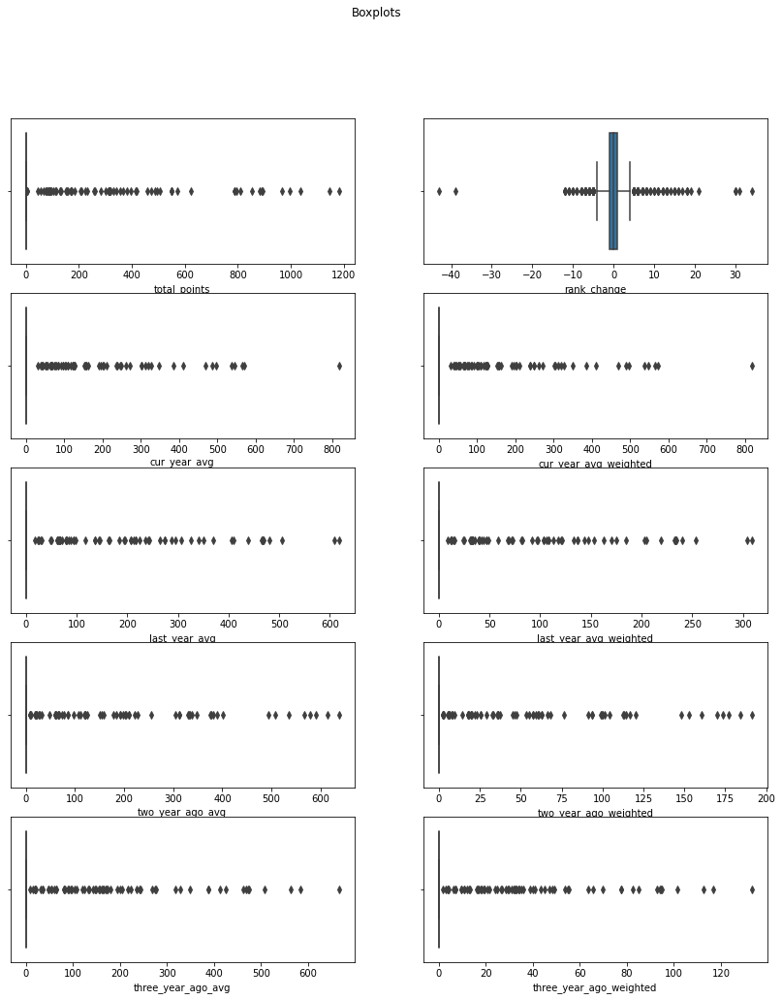

In [ ]:

fig, ((ax1, ax2), (ax3, ax4), (ax5,  ax6),  (ax7,  ax8),  (ax9,  ax10)) = plt.subplots(5,2, figsize=(14, 16))
fig.suptitle('Boxplots')
sns.boxplot(df['total_points'], ax=ax1)
sns.boxplot(df['rank_change'], ax=ax2)
sns.boxplot(df['cur_year_avg'], ax=ax3)
sns.boxplot(df['cur_year_avg_weighted'], ax=ax4)
sns.boxplot(df['last_year_avg'], ax=ax5)
sns.boxplot(df['last_year_avg_weighted'], ax=ax6)
sns.boxplot(df['two_year_ago_avg'], ax=ax7)
sns.boxplot(df['two_year_ago_weighted'], ax=ax8)
sns.boxplot(df['three_year_ago_avg'], ax=ax9)
sns.boxplot(df['three_year_ago_weighted'], ax=ax10)
plt.show()

a point to note is that the numerical columns all have outliers. 

##  External Data Source Validation

In [282]:
df2.head(4)

,rank,country_full,country_abrv,total_points,previous_points,rank_change,cur_year_avg,cur_year_avg_weighted,last_year_avg,last_year_avg_weighted,two_year_ago_avg,two_year_ago_weighted,three_year_ago_avg,three_year_ago_weighted,confederation,rank_date
0,1,Germany,GER,0.0,57,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,UEFA,1993-08-08
1,2,Italy,ITA,0.0,57,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,UEFA,1993-08-08
2,3,Switzerland,SUI,0.0,50,9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,UEFA,1993-08-08
3,4,Sweden,SWE,0.0,55,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,UEFA,1993-08-08


checking whether Germany, Italy, Switzerland and Sweden were ranked as per the given dataset : [confirmed!](https://www.fifa.com/fifa-world-ranking/associations/association/swe/men/)

#  Exploratory Analysis

using pandas proiling to highlight some of the useful EDA analysis

In [ ]:
# installing and importing from pandas profiling
!pip install pandas-profiling==2.7.1

In [ ]:
import pandas_profiling
report = pandas_profiling.ProfileReport(df=df)
report

Summarize dataset:   0%|          | 0/33 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<string>:6: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<string>:6: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.


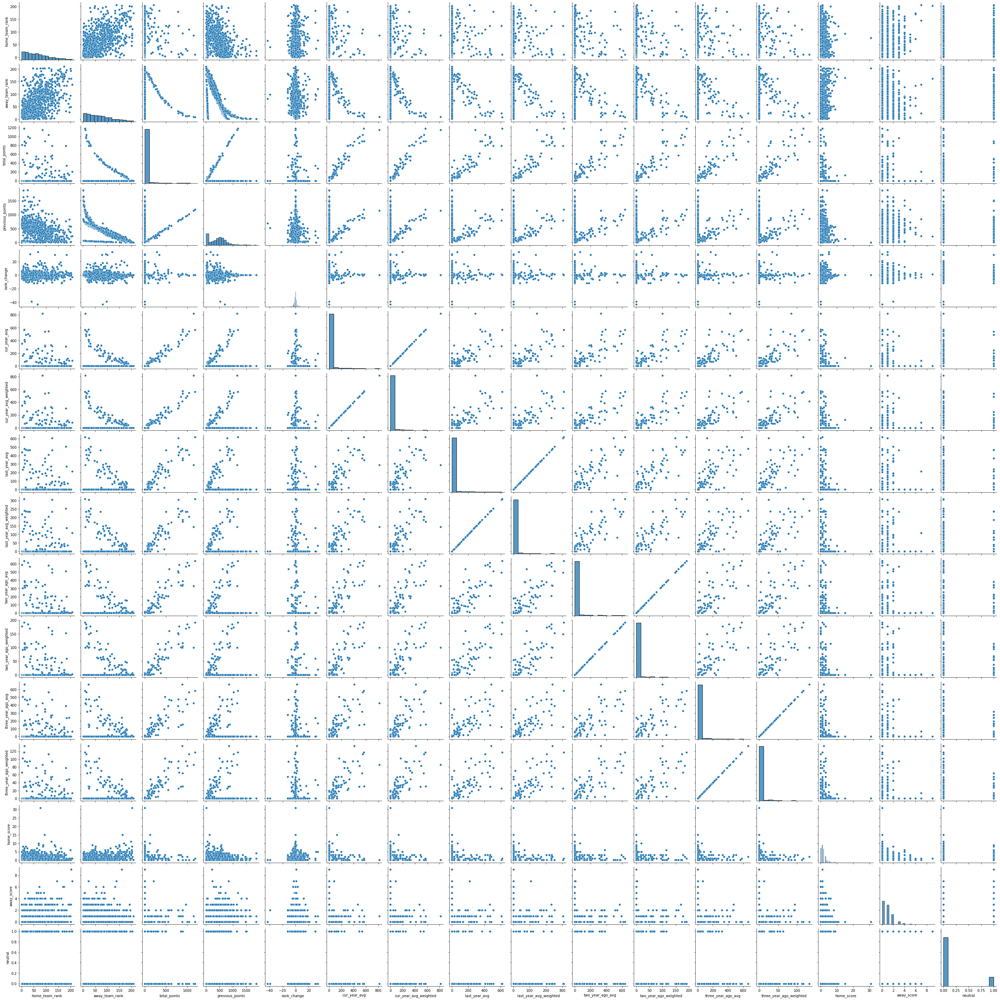

In [ ]:
# formulating a pairplot to see the scatterplots 
sns.pairplot(df)

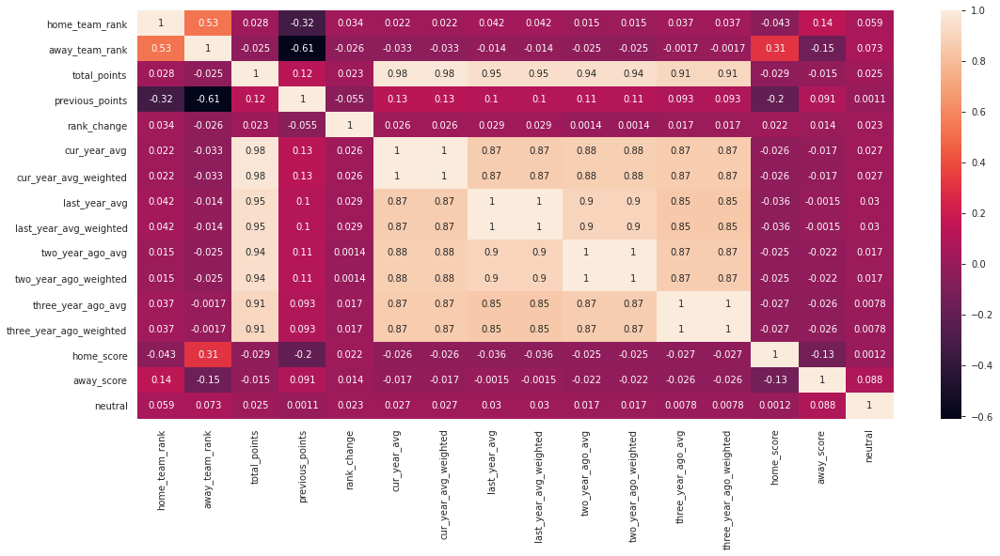

In [23]:
#a more informative heatmap of the various correlations
plt.figure(figsize=(18, 8))
sns.heatmap(df.corr(),annot=True)

#  Implementing the Solution

### performing some label encoding for modelling purposes

In [36]:
# creating instance of labelencoder
labelencoder = LabelEncoder()
# Assigning numerical values and storing in another column
df ['tournament'] = labelencoder.fit_transform(df['tournament'])
df ['neutral'] = labelencoder.fit_transform(df['neutral'])
df ['confederation'] = labelencoder.fit_transform(df['confederation'])
df ['home_team'] = labelencoder.fit_transform(df['home_team'])
df ['away_team'] = labelencoder.fit_transform(df['away_team'])


In [263]:
df.head(3)

,home_team_rank,home_team,away_team,away_team_rank,total_points,previous_points,rank_change,cur_year_avg,cur_year_avg_weighted,last_year_avg,last_year_avg_weighted,two_year_ago_avg,two_year_ago_weighted,three_year_ago_avg,three_year_ago_weighted,confederation,home_score,away_score,tournament,neutral,year,status
0,8,23,90,14,0.0,42,11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2,1,1,17,0,1993,0
1,35,40,153,94,0.0,4,31,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3,5,0,16,0,1993,2
2,59,20,150,22,0.0,47,-6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3,3,1,16,0,1993,2


# Approach 1: Polynomial Regression 

will first 
#### check for Multicolinearity using VIF

In [37]:
# the correlations between the variables
correlations = df.corr()
# computing the VIF 

pd.DataFrame(np.linalg.inv(correlations.values), index = correlations.index, columns=correlations.columns)

,home_team_rank,home_team,away_team,away_team_rank,total_points,previous_points,rank_change,cur_year_avg,cur_year_avg_weighted,last_year_avg,last_year_avg_weighted,two_year_ago_avg,two_year_ago_weighted,three_year_ago_avg,three_year_ago_weighted,confederation,home_score,away_score,tournament,neutral
home_team_rank,1.653330e+00,6.338122e-02,7.655913e-03,-9.856805e-01,8.240696e+03,8.242253e-04,-6.184182e-02,4.963659e+10,-4.963720e+10,-2.016776e-02,-2.125050e+03,-2.158033e+03,8.112624e+02,-6.397877e+03,5.556966e+03,1.110285e-01,3.547123e-01,-3.646689e-01,6.024109e-02,2.641471e-02
home_team,6.542737e-02,1.063713e+00,-2.360110e-02,-7.739053e-02,-1.906790e+04,8.828311e-03,1.922745e-04,-6.107912e+10,6.107926e+10,-1.311998e-01,4.916770e+03,1.373384e+03,1.743051e+03,8.169691e+03,-6.222447e+03,1.859468e-01,4.814167e-02,2.084491e-02,1.524251e-02,1.223783e-01
away_team,-4.100472e-03,-7.945063e-03,1.031298e+00,5.755104e-02,-3.184720e+03,6.000269e-02,-2.946383e-02,-2.884253e+10,2.884222e+10,1.412173e-01,8.208967e+02,2.114606e+03,-1.593943e+03,2.780060e+03,-2.454603e+03,1.030066e-01,7.433520e-02,-3.174897e-02,4.501951e-02,9.527672e-03
away_team_rank,-1.012197e+00,-4.073775e-02,4.985261e-02,2.559712e+00,-1.160666e+04,1.020790e+00,1.515848e-01,-9.756166e+10,9.756203e+10,-1.241392e-03,2.992874e+03,3.216039e+03,-1.319019e+03,1.044486e+04,-9.260234e+03,4.984369e-01,-5.592629e-01,3.395990e-01,-1.253232e-01,-7.857860e-02
total_points,-1.067063e+04,6.186938e+03,-3.587956e+03,-1.323844e+02,1.090651e+08,-6.569148e+02,-2.599790e+03,-4.809992e+16,4.809992e+16,1.195175e+03,-2.810597e+07,-1.130641e+08,9.517797e+07,4.606619e+09,-4.617800e+09,1.692033e+04,-9.307060e+03,1.423828e+04,-2.652917e+03,5.897640e+03
previous_points,-1.356063e-03,1.178529e-02,5.969566e-02,1.021525e+00,-1.076022e+03,1.645961e+00,1.177546e-01,-6.645861e+09,6.645550e+09,8.563526e-02,2.773398e+02,6.870765e+01,1.071516e+02,6.868499e+02,-5.769415e+02,6.504042e-02,1.624125e-02,2.334927e-03,-3.681215e-02,-6.411352e-02
rank_change,-8.360636e-02,2.938398e-02,-3.066155e-02,1.631360e-01,-3.779759e+03,1.181009e-01,1.021325e+00,-5.845225e+10,5.845210e+10,7.337210e-02,9.744725e+02,8.684912e+02,-2.506408e+02,5.752761e+03,-5.366837e+03,3.165291e-02,-6.084378e-02,2.273512e-02,6.950889e-02,-1.389965e-02
cur_year_avg,-1.465626e+10,2.504531e+10,-3.175894e+10,-6.203644e+10,-5.058552e+16,-5.507217e+09,-5.730107e+10,-1.700429e+23,1.700430e+23,9.007198e+15,4.036613e+15,4.154094e+15,4.113401e+15,2.112432e+16,-1.595850e+16,6.417490e+10,-2.197748e+10,3.645818e+10,-3.649474e+10,4.562610e+10
cur_year_avg_weighted,1.465627e+10,-2.504531e+10,3.175894e+10,6.203644e+10,5.058552e+16,5.507218e+09,5.730107e+10,1.700430e+23,-1.700430e+23,-9.007198e+15,-4.036613e+15,-4.154094e+15,-4.113401e+15,-2.112433e+16,1.595850e+16,-6.417491e+10,2.197749e+10,-3.645819e+10,3.649474e+10,-4.562610e+10
last_year_avg,6.198820e+03,-9.335475e+03,6.207427e+03,9.941608e+03,9.772591e+09,9.894129e+02,1.085993e+04,4.141513e+16,-4.141514e+16,1.590792e+01,-2.519947e+09,-9.634063e+08,-6.337559e+08,-4.901544e+09,3.903584e+09,-1.335993e+04,4.935831e+03,-8.248106e+03,6.716898e+03,-1.009041e+04


checking along the diagonal of the matrix, as expected the variables that showed high correlations with other independent variables also showed high VIF values and should be removed


In [38]:
df_poly=df.drop(['total_points','cur_year_avg','cur_year_avg_weighted',
                          'last_year_avg','last_year_avg_weighted','two_year_ago_avg',
                          'two_year_ago_weighted','three_year_ago_avg','three_year_ago_weighted'],axis=1)
df_poly

,home_team_rank,home_team,away_team,away_team_rank,previous_points,rank_change,confederation,home_score,away_score,tournament,neutral,year
0,8,23,90,14,42,11,2,1,1,17,0,1993
1,35,40,153,94,4,31,3,5,0,16,0,1993
2,59,20,150,22,47,-6,3,3,1,16,0,1993
3,65,59,125,86,16,-7,1,1,0,17,0,1993
4,67,111,7,5,51,5,3,1,3,16,0,1993
...,...,...,...,...,...,...,...,...,...,...,...,...
866,4,115,2,66,499,-2,1,3,0,17,0,2018
867,12,43,35,23,858,2,2,2,0,17,0,2018
868,14,151,151,95,381,-7,0,3,0,17,0,2018
869,22,65,56,47,603,3,1,2,2,17,0,2018


### Model 1:
To predict how many goals the home team scores.

our target variable will be the home score


In [108]:
X=df_poly.drop(['home_score'],axis=1).values
y=df_poly['home_score'].values

In [109]:
# transform the X features
poly_reg_2 = PolynomialFeatures(degree = 2) 
X_poly = poly_reg_2.fit_transform(X)

the above cell block was run severally to check for an optimal polynomial degree for X

In [110]:
# Performing Data Preprocessing
# ---
# 
X_train, X_test, y_train, y_test = train_test_split(X_poly, y, test_size=0.2, random_state=0)

In [111]:
# Scaling our Data
# ---
# 
from sklearn.preprocessing import StandardScaler
feature_scaler = StandardScaler()
X_train = feature_scaler.fit_transform(X_train)
X_test = feature_scaler.transform(X_test)

In [112]:
# fitting the polynomial regression
pol_reg = LinearRegression()
pol_reg.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [113]:
# assess the accuracy of the model
y_pred = pol_reg.predict(X_test)

print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Root Mean Squared Error: 1.526200866679481


setting a polynomial degree  for X higher than 2 increases the RMSE

#### Checking for Heteroskedasticity using the bartlett's test

also showing the residual plot

for model 1

In [114]:
# calculating the residuals by substracting the test value from the predicted 
residuals = np.subtract(y_pred, y_test)

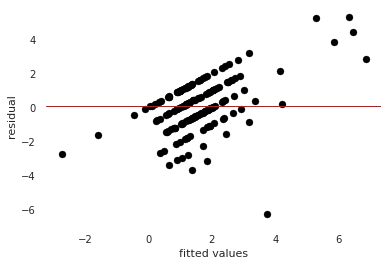

In [115]:
import matplotlib.pyplot as plt

plt.scatter(y_pred, residuals, color='black')
plt.ylabel('residual')
plt.xlabel('fitted values')
plt.axhline(y= residuals.mean(), color='red', linewidth=1)
plt.show()

In [118]:
import scipy as sp

test_result, p_value = sp.stats.bartlett(y_pred, residuals)

# computing a critical value of the chi squared distribution
degree_of_freedom = len(y_pred)-1
probability = 1 - p_value

critical_value = sp.stats.chi2.ppf(probability, degree_of_freedom)
print('The critical value is at: ', critical_value)

# If the test_result > critical value, then we reject our null
# hypothesis. There are patterns to the variance of the data

# Otherwise, we can identify no patterns, and we accept the null hypothesis that 
# the variance is homogeneous across our data

if (test_result > critical_value):
  print('the variances are unequal, and the model should be reassessed')
else:
  print('the variances are homogeneous!')


the critical value is at:  242.7803200951337
the variances are homogeneous!


###  Challenging the solution

will attempt to use the kfold cross validation with the aim of attaining an even lower RMSE. 
we will use 10 folds

In [243]:
from sklearn.model_selection import KFold

# using the same independent variables and dependent variables 
X=df_poly.drop(['home_score'],axis=1).values
y=df_poly['home_score'].values

folds = KFold(n_splits=10)

# transform the X features
poly_reg_2 = PolynomialFeatures(degree = 2) 
X_poly = poly_reg_2.fit_transform(X)

# To know how many folds we set up 
print('we are using ' +str(folds.get_n_splits(X_poly)) + ' folds')

# We assess the 10 models based on the folds we created.
RMSES = [] 
count = 1 
for train_index, test_index in folds.split(X_poly):
  print('\nTraining model ' + str(count))
  
  # With 5 folds, we will end up with 80% of our data in the training set, and 20% in the test set, just as above
  X_train, X_test = X_poly[train_index], X_poly[test_index]
  y_train, y_test = y[train_index], y[test_index]
  

  # Scaling our Data
  from sklearn.preprocessing import StandardScaler
  feature_scaler = StandardScaler()
  X_train = feature_scaler.fit_transform(X_train)
  X_test = feature_scaler.transform(X_test)
  
  # fitting the model 
  regressor = LinearRegression()  
  regressor.fit(X_train, y_train)
  
  # assess the accuraccy of the model
  y_pred = regressor.predict(X_test)
  
  rmse_value =  np.sqrt(metrics.mean_squared_error(y_test, y_pred))
  RMSES.append(rmse_value)
  
  print('Model ' + str(count) + ' Root Mean Squared Error:',rmse_value)
  count = count + 1

we are using 10 folds

Training model 1
Model 1 Root Mean Squared Error: 2.22391154928988

Training model 2
Model 2 Root Mean Squared Error: 1.5414295608846182

Training model 3
Model 3 Root Mean Squared Error: 3.2790969988763323

Training model 4
Model 4 Root Mean Squared Error: 1.4132365582134498

Training model 5
Model 5 Root Mean Squared Error: 1.8386230747147152

Training model 6
Model 6 Root Mean Squared Error: 1.872503802743374

Training model 7
Model 7 Root Mean Squared Error: 1.334597970951994

Training model 8
Model 8 Root Mean Squared Error: 1.2518787095233692

Training model 9
Model 9 Root Mean Squared Error: 1.5940577818105228

Training model 10
Model 10 Root Mean Squared Error: 2.5034825445641307


In [244]:
np.mean(RMSES)

1.8852818551572383

### Model 2:
To predict how many goals the away team scores.

In [119]:
X=df_poly.drop(['away_score'],axis=1).values
y=df_poly['away_score'].values

In [120]:
# transform the X features
poly_reg_2 = PolynomialFeatures(degree = 2) 
X_poly = poly_reg_2.fit_transform(X)

the above cell block was run severally to check for an optimal polynomial degree for X

In [121]:
# Performing Data Preprocessing
# ---
# 
X_train, X_test, y_train, y_test = train_test_split(X_poly, y, test_size=0.2, random_state=0)

In [122]:
# Scaling our Data
# ---
# 
from sklearn.preprocessing import StandardScaler
feature_scaler = StandardScaler()
X_train = feature_scaler.fit_transform(X_train)
X_test = feature_scaler.transform(X_test)

In [123]:
# fitting the polynomial regression
pol_reg = LinearRegression()
pol_reg.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [124]:
# assess the accuraccy of the model
y_pred = pol_reg.predict(X_test)

print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Root Mean Squared Error: 1.2906599189726133


Again, setting the polynomial degree for X higher than 2 increases the RMSE

#### Checking for Heteroskedasticity using the bartlett's test

for model 2


In [125]:
# calculating the residuals by substracting the test value from the predicted 
residuals = np.subtract(y_pred, y_test)

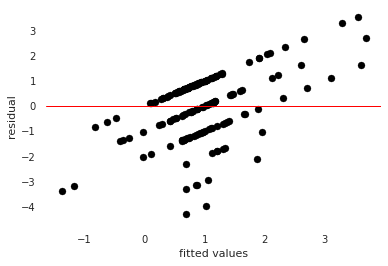

In [128]:
plt.scatter(y_pred, residuals, color='black')
plt.ylabel('residual')
plt.xlabel('fitted values')
plt.axhline(y= residuals.mean(), color='red', linewidth=1)
plt.show()

In [127]:
import scipy as sp

test_result, p_value = sp.stats.bartlett(y_pred, residuals)

# computing a critical value of the chi squared distribution
degree_of_freedom = len(y_pred)-1
probability = 1 - p_value

critical_value = sp.stats.chi2.ppf(probability, degree_of_freedom)
print('The critical value is at: ',critical_value)

# If the test_result > critical value, then we reject our null
# hypothesis. There are patterns to the variance of the data

# Otherwise, we can identify no patterns, and we accept the null hypothesis that 
# the variance is homogeneous across our data

if (test_result > critical_value):
  print('the variances are unequal, and the model should be reassessed')
else:
  print('the variances are homogeneous!')


The critical value is at:  339.73486706491775
the variances are homogeneous!


###  Challenging the solution


we will also use the kfold cross validation for the second model with the aim of attaining an even lower RMSE. 

we will use 10 folds

In [245]:
from sklearn.model_selection import KFold

# using the same independent variables and dependent variables 
X=df_poly.drop(['away_score'],axis=1).values
y=df_poly['away_score'].values

folds = KFold(n_splits=10)

# transform the X features
poly_reg_2 = PolynomialFeatures(degree = 2) 
X_poly = poly_reg_2.fit_transform(X)

# To know how many folds we set up 
print('we are using ' +str(folds.get_n_splits(X_poly)) + ' folds')

# We assess the 10 models based on the folds we created.
RMSES = [] 
count = 1 
for train_index, test_index in folds.split(X_poly):
  print('\nTraining model ' + str(count))
  
  # With 5 folds, we will end up with 80% of our data in the training set, and 20% in the test set, just as above
  X_train, X_test = X_poly[train_index], X_poly[test_index]
  y_train, y_test = y[train_index], y[test_index]

  # Scaling our Data
  from sklearn.preprocessing import StandardScaler
  feature_scaler = StandardScaler()
  X_train = feature_scaler.fit_transform(X_train)
  X_test = feature_scaler.transform(X_test)

  # fitting the model 
  regressor = LinearRegression()  
  regressor.fit(X_train, y_train)
  
  # assess the accuracy of the model
  y_pred = regressor.predict(X_test)
  
  rmse_value =  np.sqrt(metrics.mean_squared_error(y_test, y_pred))
  RMSES.append(rmse_value)
  
  print('Model ' + str(count) + ' Root Mean Squared Error:',rmse_value)
  count = count + 1

we are using 10 folds

Training model 1
Model 1 Root Mean Squared Error: 1.3473376611082177

Training model 2
Model 2 Root Mean Squared Error: 1.039461302052452

Training model 3
Model 3 Root Mean Squared Error: 2.0595000875481118

Training model 4
Model 4 Root Mean Squared Error: 1.262075738578422

Training model 5
Model 5 Root Mean Squared Error: 1.0367776180081574

Training model 6
Model 6 Root Mean Squared Error: 1.25650006606034

Training model 7
Model 7 Root Mean Squared Error: 1.226135122884393

Training model 8
Model 8 Root Mean Squared Error: 1.0173445634355172

Training model 9
Model 9 Root Mean Squared Error: 1.1189175166488647

Training model 10
Model 10 Root Mean Squared Error: 1.415721081025888


In [246]:
np.mean(RMSES)


1.2779770757350364

# Approach 2: Logistic Regression

Here, we are to perform some feature engineering so as to figure out from the home team’s perspective 

if the game is a Win, Lose or a Draw (W, L, D)

### performing feature engineering

Coming up with a column "status" which shows if a match was a win, draw or lose for the home team.


---


This is made possible by taking the difference in the home score and away score  then determinine if it is a win,a draw or a lose

In [129]:
# taking the differences in the scores made in a match
df['goal_difference']=df['home_score']-df['away_score']

In [130]:
# determining if the score is a win, a lose or a draw
status=[]
for i in df['goal_difference']:
  if i<0:
    status.append('lose')
  elif i>0:
    status.append('win')
  else:
    status.append('draw')
df['status']= status

In [131]:
# dropping the goal difference column
df.drop('goal_difference',axis=1,inplace=True)
df.head(5)

,home_team_rank,home_team,away_team,away_team_rank,total_points,previous_points,rank_change,cur_year_avg,cur_year_avg_weighted,last_year_avg,last_year_avg_weighted,two_year_ago_avg,two_year_ago_weighted,three_year_ago_avg,three_year_ago_weighted,confederation,home_score,away_score,tournament,neutral,year,status
0,8,23,90,14,0.0,42,11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2,1,1,17,0,1993,draw
1,35,40,153,94,0.0,4,31,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3,5,0,16,0,1993,win
2,59,20,150,22,0.0,47,-6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3,3,1,16,0,1993,win
3,65,59,125,86,0.0,16,-7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,1,0,17,0,1993,win
4,67,111,7,5,0.0,51,5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3,1,3,16,0,1993,lose


In [132]:
# we will then have to labelencode for modeling purposes
df ['status'] = labelencoder.fit_transform(df['status'])

### Feature reduction

will use LDA approach

this will attempt to find input variables that achieves the maximum separation for samples between classes of the status

In [266]:
# Separating our target label (type) from the other features
feat = df.drop('status', 1)
status_label = df['status']


# Subject our features to LDA model
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA

# Create an instance of LDA
lda = LDA()
lda = lda.fit(feat, status_label)
lda_feat = lda.transform(feat)

#lda coefficients
lda.coef_
# Since the coefficients are in an array, we need to create a dataframe so that we can extract the name of the columns
f_imp = pd.DataFrame(index=feat.columns.values, data=lda.coef_[0].T)
f_imp.sort_values(0, ascending=False)

,0
three_year_ago_weighted,0.005322
home_team_rank,0.001526
three_year_ago_avg,0.001064
last_year_avg_weighted,0.000598
away_team,0.000449
last_year_avg,0.000299
tournament,0.000274
previous_points,0.000001
total_points,-0.000097
cur_year_avg,-0.000342


features which carry more weeight have a negative coefficient

### Modeling using logistic regression 

using the remaining features to create a model

In [267]:
# Splitting our dataset
#
X = df[['three_year_ago_weighted','home_team_rank','three_year_ago_avg','last_year_avg_weighted','away_team','last_year_avg','tournament']].values
y = df['status'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .2, random_state=0)

In [268]:
# Scaling our Data
# ---
# 
from sklearn.preprocessing import StandardScaler
feature_scaler = StandardScaler()
X_train = feature_scaler.fit_transform(X_train)
X_test = feature_scaler.transform(X_test)

In [269]:
# Fitting our model
# 
LogReg = LogisticRegression()
LogReg.fit(X_train, y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [270]:
# Using our model to make a prediction
#
y_pred = LogReg.predict(X_test)

In [271]:
# Evaluating the model
#
from sklearn.metrics import confusion_matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
confusion_matrix


array([[ 0,  4, 48],
       [ 0,  4, 36],
       [ 0,  6, 77]])

In [272]:
#checking the accuracy score
accuracy= accuracy_score(y_test,y_pred)
accuracy

0.46285714285714286

###  Challenging the solution

* Attempting to challenge the solution by performing Hyperparameter tuning

using GridSearchCV

In [273]:
# Creating regularization penalty space
penalty = ['l1','l2']

# Creating regularization hyperparameter space
C = [1.0,10,100,1000]

# Creating hyperparameter options
hyperparameters = dict(C=C, penalty=penalty)

In [274]:
from sklearn.model_selection import GridSearchCV
# Creating grid search using 10-fold cross validation
clf = GridSearchCV(LogReg, hyperparameters, cv=10, verbose=0,scoring='accuracy')

In [275]:
# Fitting grid search
best_model = clf.fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.

  FitFailedWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.

  FitFailedWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:536: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
ValueError: Solver lbfgs supports only 'l2' or 'none' penalties, got l1 penalty.

  FitFailedWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/model_se

In [276]:
# Viewing best hyperparameters
print('Best Penalty:', best_model.best_estimator_.get_params()['penalty'])
print('Best C:', best_model.best_estimator_.get_params()['C'])

Best Penalty: l2
Best C: 1.0


In [277]:
accuracy=best_model.best_score_
accuracy

0.5099792960662526

* we could also try using the features with negative coefficients.
from LDA feature reduction which seemingly carried more weight

In [278]:
# Splitting our dataset
#
X = df[['home_score','away_score','neutral','rank_change']].values
y = df['status'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .2, random_state=0)

In [279]:
# Scaling our Data
# ---
# 
from sklearn.preprocessing import StandardScaler
feature_scaler = StandardScaler()
X_train = feature_scaler.fit_transform(X_train)
X_test = feature_scaler.transform(X_test)

In [280]:
# Fitting our model
# 
LogReg = LogisticRegression()
LogReg.fit(X_train, y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [281]:
# Using our model to make a prediction
#
y_pred = LogReg.predict(X_test)

#checking the accuracy score
accuracy= accuracy_score(y_test,y_pred)
accuracy

1.0

# Conclusions 1.0

In both cases the data was tested for multicolinearity and the affected columns removed. furthermore the data was homogeneous data 


for model 1:
After coming up with the model the root mean squared error (RMSE) was 1.526
however, challenging the solution using Kfold cross validation showed that the average of the 10 folds increased the RMSE to 1.885.in the training models of the cross validation .. there were atleast 2 models which had RMSE lower than that of our model

for model 2: the RMSE for the model was 1.29.challenging the solution showed that the average RMSE for the 10 folds lowered to 1.27. Most of the training models from the cross validation had lower RMSE than that of the RMSE

# Conclusions 2.0

using the listed features from the LDA reduction technique performed poorly with an accuracy of 0.46. Challenging the question however, using hyperparameter tuning, inncreased the accuracy to 0.509 with penalty of L2 and C=1.0

using the features which had negative coefficient from the LDA reduction technique gave an accuracy of 1